<center>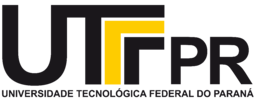</center>




 ## <center> CURSO: Engenharia de Computação (EC) </center>

#### <center> Disciplina: **OPCPF-Processamento Digital de Imagens** </center>
>#### Professor: Fabio Alexandre SPANHOL, faspanhol@gmail.com

>#### Acadêmicos:
>>#### Marcos Vinicius Rocha da Silva | RA:2159678
>>#### Fellipe de Souza Reis | RA: 1683969
>>#### Renan Carlo de Souto | RA: 1626523
>>#### Lucca Gabriel | RA: 1825224

# 1 Crie uma base de imagens. Utilize o GitHub para hospedar o projeto

In [ ]:
#Organize uma estrutura de diretório com um diretório para cada classe identificado com o nome da respectivaclasse.Compacte a base de imagens em um arquivo tar.gz.
!curl -o metadata.json https://raw.githubusercontent.com/dev-marcos/Digital-image-processing/main/ft-DB/metadata.json
!curl -o ft-DB.tar https://raw.githubusercontent.com/dev-marcos/Digital-image-processing/main/ft-DB/ft-DB.tar
!tar xf ft-DB.tar
!rm ft-DB.tar

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  350k  100  350k    0     0  2262k      0 --:--:-- --:--:-- --:--:-- 2262k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 28.8M  100 28.8M    0     0  70.1M      0 --:--:-- --:--:-- --:--:-- 70.1M


In [ ]:
ft_class = ["apple", "avocado", "banana", "grape", "guava", "mango", "orange", "pear", "pineapple"]
ft_version = ['V1', 'V2']
ft_color = ['B', 'W']

### Crie um arquivo de metadados. | Crie uma função para exibir os metadados.

In [ ]:
import json
metadata = json.load(open("metadata.json"))

In [ ]:
def get_metada(img_name):

  classes = ["apple", "avocado", "banana", "grape", "guava", "mango", "orange", "pear", "pineapple"]
  url = "720p/" + classes[int(img_name.split("-")[1])] + "/" + img_name

  return metadata[url]

In [ ]:
get_metada("0-04-V1-B.png")

{'Image Size': [[720, 720]],
 'Image Height': [720],
 'Image Width': [720],
 'Image Format': ['PNG'],
 'Image Mode': ['RGB'],
 'Image is Animated': [False],
 'Frames in Image': 1}

###Crie um Jupyter Notebook (NB) para exibir as imagens, organizadas pelas classes. Dica: skimage.util.montage

In [ ]:
import skimage.io
import skimage.util
from matplotlib import pyplot as plt

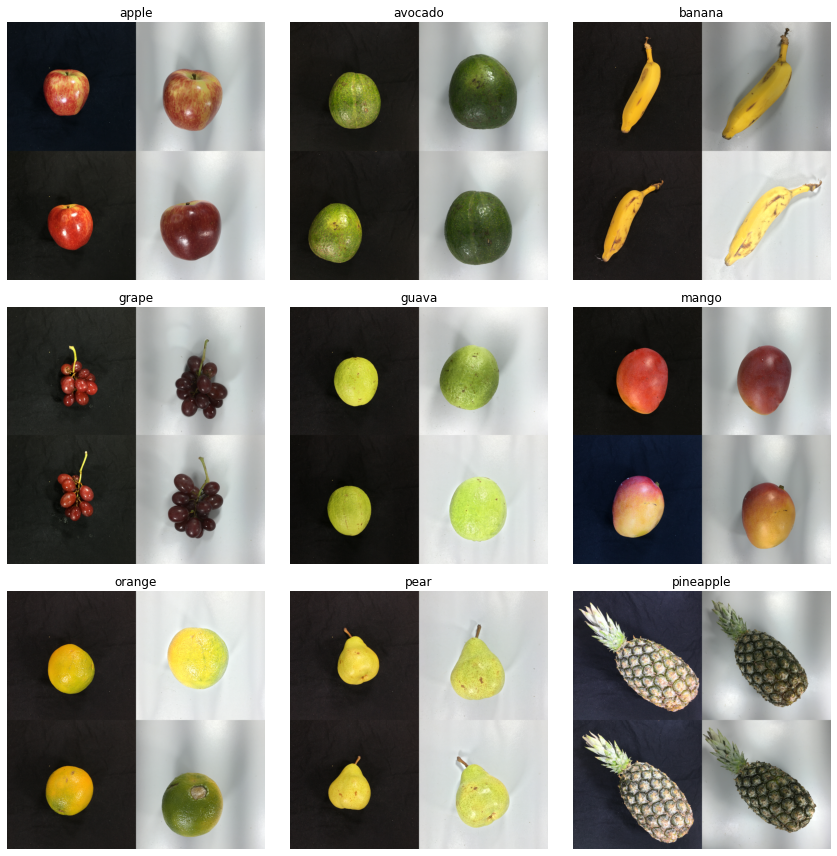

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(12, 12))
ax = axes.ravel()

for x in range(len(ft_class)):
  img_fruit = []
  for ver in ft_version:
    for col in ft_color:
      img_fruit.append(skimage.io.imread(f'ft-DB/{ft_class[x]}/0-{str(x).zfill(2)}-{ver}-{col}.png'))
  m = skimage.util.montage(img_fruit, multichannel=True)
  ax[x].imshow(m, cmap='gray')
  ax[x].set_axis_off()
  ax[x].set_title(f"{ft_class[x]}")

fig.tight_layout()
plt.show()

# 2 Data augmentation. Crie um augmented_dataset: uma versão aumentada em 3 vezes da base de imagensoriginal.

In [ ]:
#import cv2
#import numpy as np
#import matplotlib.pyplot as plt
#import skimage as ski
#from skimage import io
#from google.colab import drive

<ipython-input-4-136a8d0f8060>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


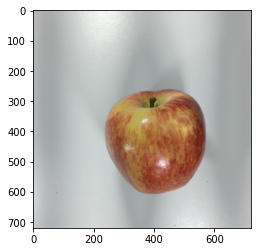

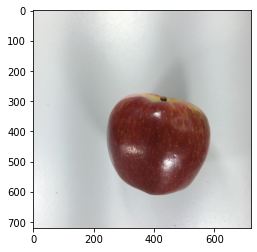

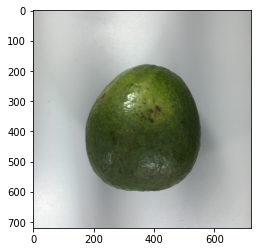

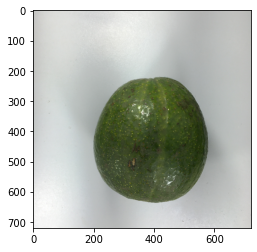

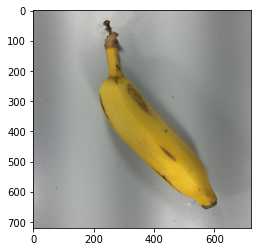

...

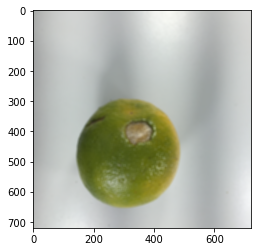

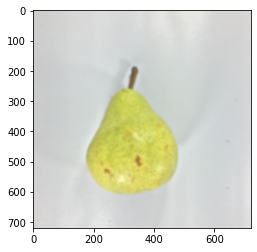

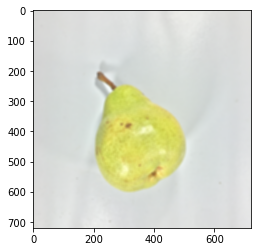

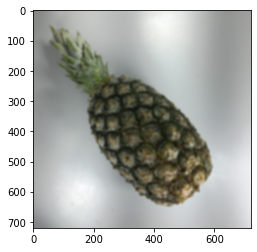

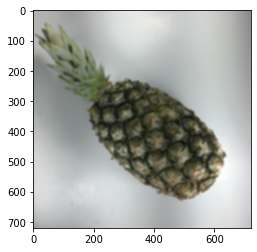

In [ ]:

import cv2
import numpy as np
import matplotlib.pyplot as plt
import skimage as ski
from skimage import io
from google.colab import drive

def read_image(url):
  return ski.io.imread(url)

def filter_log(image):
  c = 255 / np.log(1 + np.max(image))
  log_image = c * (np.log(image + 1))
  log_image = np.array(log_image, dtype = np.uint8)
  return log_image

def filter_pot(image, gamma=2.2):
  gamma_corrected = np.array(255*(image / 255) ** gamma, dtype = 'uint8')
  return gamma_corrected

def filter_cnv(image):
  flt_img = cv2.blur(image,(9,9))
  return flt_img


def filter_mirroring(image):
  flipHorizontal = cv2.flip(image, 1)
  return flipHorizontal

#def save_mask_image(image):
  cv2.imwrite('/content/drive/MyDrive/PDI/0-08-V1-W-mask.png', cv2.cvtColor(image1, cv2.COLOR_RGB2BGR))


def show_image(image):
  fig, ax = plt.subplots()
  plt.imshow(image)


fruits = [('apple', '00'), ('avocado', '01'), ('banana', '02'), ('grape', '03'), ('guava', '04'), ('mango', '05'), ('orange', '06'), ('pear', '07'), ('pineapple', '08')]
versions = ['V1', 'V2']
colors = ['B', 'W']
operations = ['', 'mirror']
lows = {
  '00': np.array([0, 0, 0]),
  '01': np.array([0, 0, 0]),
  '02': np.array([160, 110, 0]),
  '03': np.array([0, 25, 0]),
  '04': np.array([0, 0, 0]),
  '05': np.array([0, 0, 0]),
  '06': np.array([0, 0, 0]),
  '07': np.array([0, 0, 0]), 
  '08': np.array([0, 0, 0])
}
highs = {
  '00': np.array([255,200,145]),
  '01': np.array([145,255,80]),
  '02': np.array([255,255,150]),
  '03': np.array([230,100,230]),
  '04': np.array([255,255,140]),
  '05': np.array([255,255,115]),
  '06': np.array([255,255,140]),
  '07': np.array([255,255,170]), 
  '08': np.array([255,255,110])
}

result = []
mirroring_image = []
pot_image = []
cnv_image = []

# Generate pot, cnv and mirror
url_base = 'https://raw.githubusercontent.com/Fellipesre/pdi/main/'
for fruit in fruits:
  url_fruta = url_base + fruit[0] + '/0-' + fruit[1] + '-'
  for version in versions:
    url_version = url_fruta + version + '-' 
    for color in ['W']: 
      url_color = url_version + color + '.png'
      image = read_image(url_color)
      image_mirror = filter_mirroring(image)
      mirroring_image.append(image_mirror)
      image_pot = filter_pot(image)
      pot_image.append(image_pot)
      image_cnv=filter_cnv(image)
      cnv_image.append(image_cnv)
      cv2.imwrite('/content/drive/MyDrive/PDI/' + '0-' + fruit[1] + '-' + version + '-' + color + 'mirror.png', cv2.cvtColor(image_mirror, cv2.COLOR_RGB2BGR))
      cv2.imwrite('/content/drive/MyDrive/PDI/' + '0-' + fruit[1] + '-' + version + '-' + color + 'pot.png', cv2.cvtColor(image_pot, cv2.COLOR_RGB2BGR))
      cv2.imwrite('/content/drive/MyDrive/PDI/' + '0-' + fruit[1] + '-' + version + '-' + color + 'cnv.png', cv2.cvtColor(image_cnv, cv2.COLOR_RGB2BGR))
  
for image in mirroring_image:
	show_image(image)
for image in pot_image:
	show_image(image)
for image in cnv_image:
	show_image(image)


# 3 Data normalization. Crie um normalized_dataset utilizando equalização de histogramas



---


**HISTOGRAMA**

<ipython-input-5-3506ed8e6aa6>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()
<ipython-input-5-3506ed8e6aa6>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()
<ipython-input-5-3506ed8e6aa6>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()
<ipython-input-5-3506ed8e6aa6>:19: RuntimeW

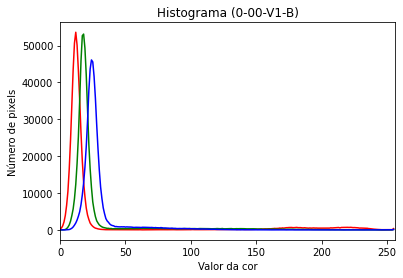

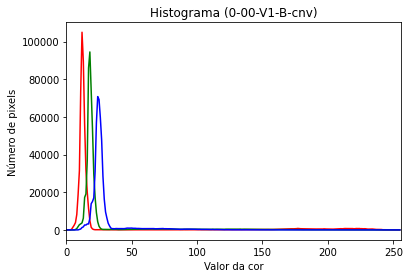

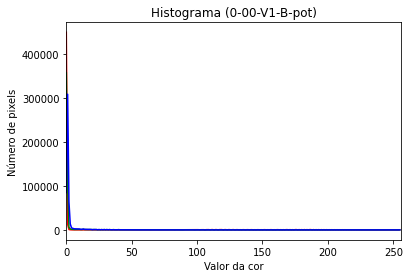

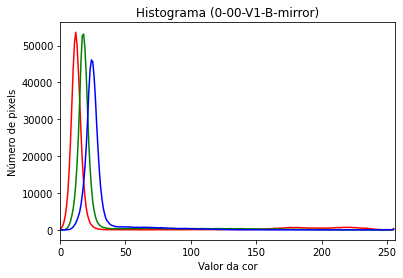

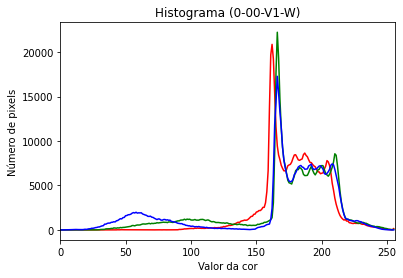

...

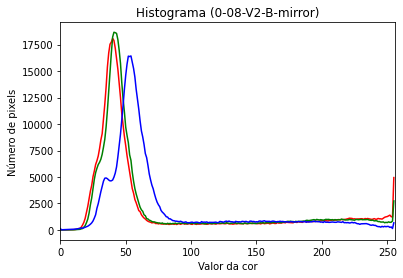

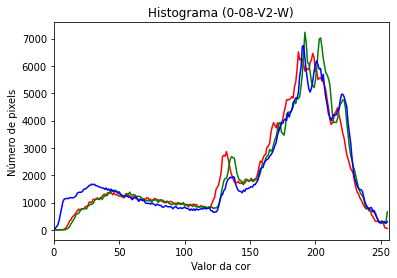

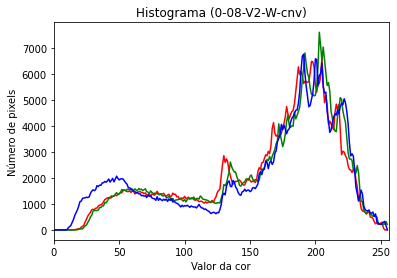

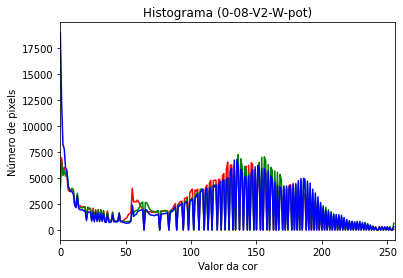

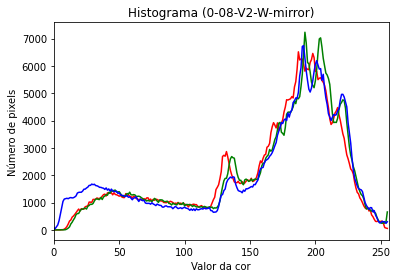

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import skimage as ski
from skimage import io
from google.colab import drive
import math
from google.colab import files

def read_image(url):
  return ski.io.imread(url)

def histogram_image(url):
  # imagem
  image = read_image(url)

  # gera e plota o histograma
  colors = ("red", "green", "blue")
  plt.figure()
  plt.xlim([0, 256])
  for channel_id, color in enumerate(colors):
      histogram, bin_edges = np.histogram(
          image[:, :, channel_id], bins=256, range=(0, 256)
      )
      plt.plot(bin_edges[0:-1], histogram, color=color)

  plt.title("Histograma")
  plt.xlabel("Valor da cor")
  plt.ylabel("Número de pixels")

  index = url.rfind('/')
  #new_name = url[index+1:-4] + '-' + 'hist' + '.png'
  #plt.savefig(new_name)
  #files.download(new_name)
  plt.title("Histograma (" + url[index+1:-4] + ")")

fruits = [('apple', '00'), ('avocado', '01'), ('banana', '02'), ('grape', '03'), ('guava', '04'), ('mango', '05'), ('orange', '06'), ('pear', '07'), ('pineapple', '08')]
versions = ['V1', 'V2']
colors = ['B', 'W']
operations = ['', 'cnv', 'pot', 'mirror']
url_original_images = []
url_extended_images = []

# Save the images
url_base = 'https://raw.githubusercontent.com/dev-marcos/Digital-image-processing/main/ft-DB/720p/'
for fruit in fruits:
  url_fruta = url_base + fruit[0] + '/0-' + fruit[1] + '-'
  for version in versions:
    url_version = url_fruta + version + '-'
    for color in colors:
      url_color = url_version + color + '.png'
      url_original_images.append(url_color)

url_base = 'https://raw.githubusercontent.com/Fellipesre/pdi/main/'
for fruit in fruits:
  url_fruta = url_base + fruit[0] + '/0-' + fruit[1] + '-'
  for version in versions:
    url_version = url_fruta + version + '-'
    for color in colors:
      url_color = url_version + color
      for operation in operations:
        if operation != '':
          url_operation = url_color + '-' + operation + '.png'
        else:
          url_operation = url_color + '.png'
        url_extended_images.append(url_operation)

for url in url_extended_images:
  histogram_image(url)



---


**EQUALIZAÇÃO**

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-6-311695a3c730>:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


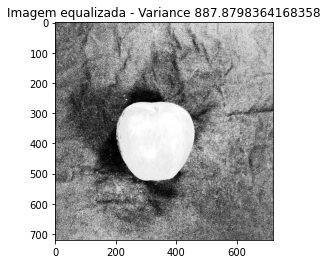

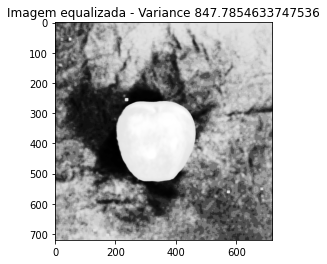

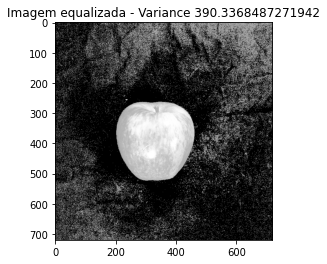

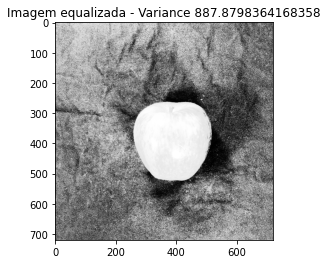

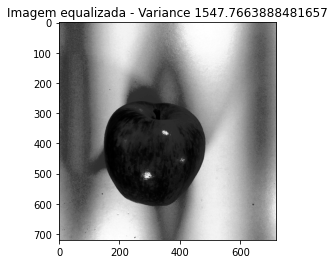

...

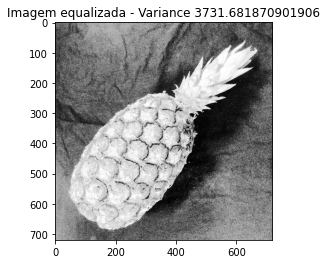

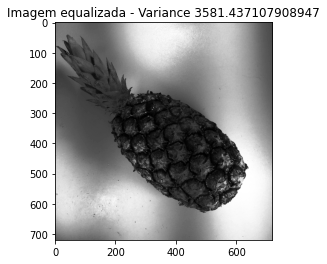

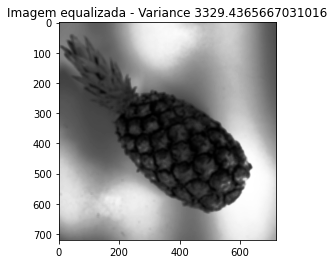

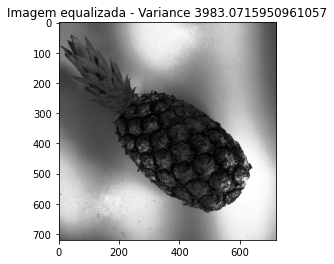

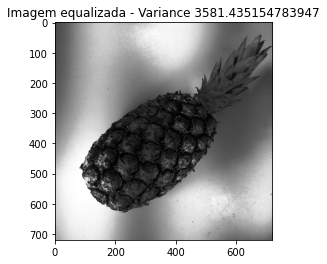

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import skimage as ski
from skimage import io
from google.colab import drive
import math
from google.colab import files

def read_image(url):
  return ski.io.imread(url)

def equalize_image(url):
  # imagem, imagem preto e branco e imagem equalizada
  image = read_image(url)
  gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  equ = cv2.equalizeHist(gray) 

  # calculo da variancia
  imean = np.mean(gray)
  grayf = gray.astype(np.float32)
  grayf2 = grayf * grayf
  imeanf2 = np.mean(grayf2)
  ivar = imeanf2 - imean**2
  istd = math.sqrt(ivar)

  # plota a imagem equalizada
  fig, ax = plt.subplots()
  plt.title("Imagem equalizada - Variance " + str(ivar))
  plt.imshow(equ, cmap='gray')

  #index = url.rfind('/')
  #new_name = url[index+1:-4] + '-' + 'equ-var' + '.png'
  #plt.savefig(new_name)
  #files.download(new_name) 

fruits = fruits = [('apple', '00'), ('avocado', '01'), ('banana', '02'), ('grape', '03'), ('guava', '04'), ('mango', '05'), ('orange', '06'), ('pear', '07'), ('pineapple', '08')]
versions = ['V1', 'V2']
colors = ['B', 'W']
operations = ['', 'cnv', 'pot', 'mirror']
url_original_images = []
url_extended_images = []

drive.mount('/content/drive')

# Save the images
url_base = 'https://raw.githubusercontent.com/dev-marcos/Digital-image-processing/main/ft-DB/720p/'
for fruit in fruits:
  url_fruta = url_base + fruit[0] + '/0-' + fruit[1] + '-'
  for version in versions:
    url_version = url_fruta + version + '-'
    for color in colors:
      url_color = url_version + color + '.png'
      url_original_images.append(url_color)

url_base = 'https://raw.githubusercontent.com/Fellipesre/pdi/main/'
for fruit in fruits:
  url_fruta = url_base + fruit[0] + '/0-' + fruit[1] + '-'
  for version in versions:
    url_version = url_fruta + version + '-'
    for color in colors:
      url_color = url_version + color
      for operation in operations:
        if operation != '':
          url_operation = url_color + '-' + operation + '.png'
        else:
          url_operation = url_color + '.png'
        url_extended_images.append(url_operation)

for url in url_extended_images:
  equalize_image(url)

  



---


**PROTÓTIPO MEDIO**

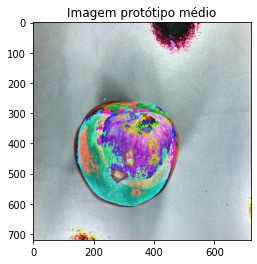

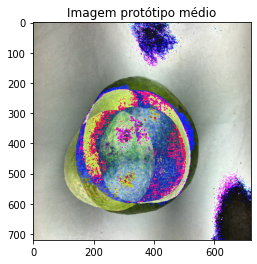

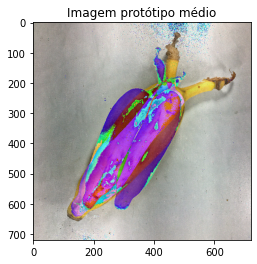

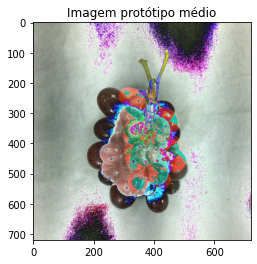

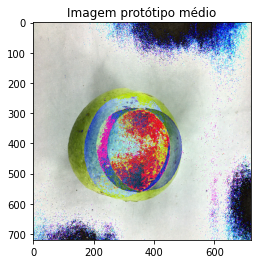

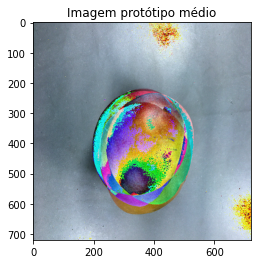

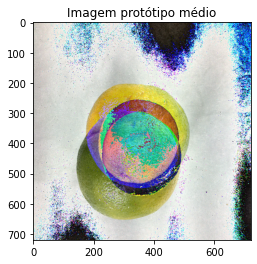

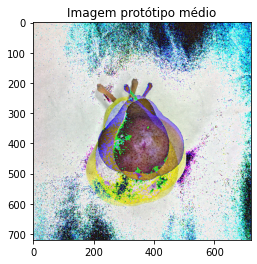

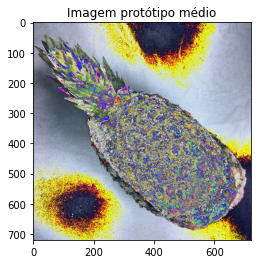

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import skimage as ski
from skimage import io
from google.colab import drive
import math
from google.colab import files

def read_image(url):
  return ski.io.imread(url)

def median_prototype_image(list_img):
  num_image = len(list_img)
  result = list_img[0].copy()
  for line in result:
    for pixel in line:
      for color in pixel:
        color = int(color/num_image)
  list_img.pop(0)
  for img in list_img:
    img_to_sum = img
    for line in img_to_sum:
      for pixel in line:
        for color in pixel:
          color = int(color/num_image)

    result = result + img_to_sum
  fig, ax = plt.subplots()
  plt.title("Imagem protótipo médio")
  plt.imshow(result)

fruits = [('apple', '00'), ('avocado', '01'), ('banana', '02'), ('grape', '03'), ('guava', '04'), ('mango', '05'), ('orange', '06'), ('pear', '07'), ('pineapple', '08')]
versions = ['V1', 'V2']
colors = ['B', 'W']
operations = ['', 'cnv', 'pot', 'mirror']
url_original_images = []
url_extended_images = []

# Save the images
url_base = 'https://raw.githubusercontent.com/dev-marcos/Digital-image-processing/main/ft-DB/720p/'
for fruit in fruits:
  list_img = []
  url_fruta = url_base + fruit[0] + '/0-' + fruit[1] + '-'
  for version in versions:
    url_version = url_fruta + version + '-'
    for color in colors:
      url_color = url_version + color + '.png'
      image = read_image(url_color)
      list_img.append(image)
  median_prototype_image(list_img)


# 4 Segmentação do objeto de interesse

In [ ]:
!curl -o ground-truth.tar https://raw.githubusercontent.com/dev-marcos/Digital-image-processing/main/ft-DB/ground-truth.tar
!tar xf ground-truth.tar
!rm ground-truth.tar

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 18.3M  100 18.3M    0     0  46.3M      0 --:--:-- --:--:-- --:--:-- 46.4M


**SEGMENTAÇÃO DE OBJETO VIA CÓDIGO**

<ipython-input-7-c879b11349c4>:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


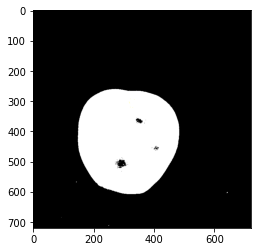

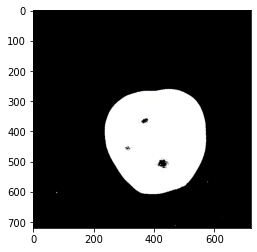

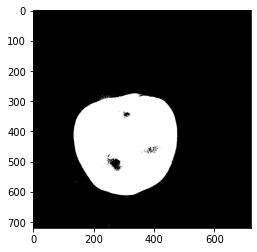

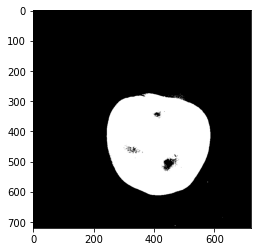

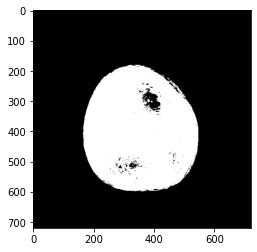

...

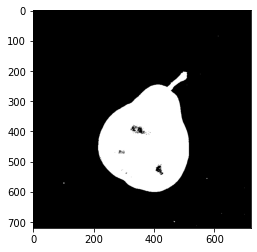

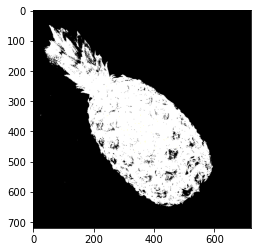

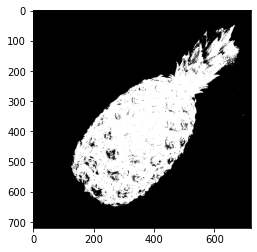

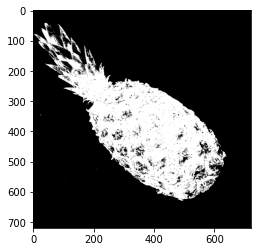

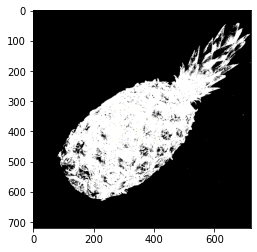

In [ ]:

import cv2
import numpy as np
import matplotlib.pyplot as plt
import skimage as ski
from skimage import io
from google.colab import drive

def read_image(url):
  return ski.io.imread(url)

def mask_white(image, low, high):
  mask = cv2.inRange(image, low, high)
  result = cv2.bitwise_and(image, image, mask=mask)
  return result

#def save_mask_image(image):
  cv2.imwrite('/content/drive/MyDrive/PDI/0-08-V1-W-mask.png', cv2.cvtColor(image1, cv2.COLOR_RGB2BGR))

def show_image(image):
  fig, ax = plt.subplots()
  plt.imshow(image)


fruits = [('apple', '00'), ('avocado', '01'), ('banana', '02'), ('grape', '03'), ('guava', '04'), ('mango', '05'), ('orange', '06'), ('pear', '07'), ('pineapple', '08')]
versions = ['V1', 'V2']
colors = ['B', 'W']
operations = ['', 'mirror']
lows = {
  '00': np.array([0, 0, 0]),
  '01': np.array([0, 0, 0]),
  '02': np.array([160, 110, 0]),
  '03': np.array([0, 25, 0]),
  '04': np.array([0, 0, 0]),
  '05': np.array([0, 0, 0]),
  '06': np.array([0, 0, 0]),
  '07': np.array([0, 0, 0]), 
  '08': np.array([0, 0, 0])
}
highs = {
  '00': np.array([255,200,145]),
  '01': np.array([145,255,80]),
  '02': np.array([255,255,150]),
  '03': np.array([230,100,230]),
  '04': np.array([255,255,140]),
  '05': np.array([255,255,115]),
  '06': np.array([255,255,140]),
  '07': np.array([255,255,170]), 
  '08': np.array([255,255,110])
}

result = []
  
# Generate mask
url_base = 'https://raw.githubusercontent.com/Fellipesre/pdi/main/'
for fruit in fruits:
  url_fruta = url_base + fruit[0] + '/0-' + fruit[1] + '-'
  path_img = '0-' + fruit[1] + '-'
  for version in versions:
    url_version = url_fruta + version + '-'
    path_img = path_img + version + '-'
    for color in ['W']:
      url_color = url_version + color
      path_img = path_img + color
      for operation in operations:
        if operation != '':
          url_operation = url_color + '-' + operation + '.png'
          path_img = path_img + '-' + operation
        else:
          url_operation = url_color + '.png'
          path_img = path_img
        image = read_image(url_operation)
        mask_image = mask_white(image, lows.get(fruit[1]), highs.get(fruit[1]))
        mask_image[mask_image != 0] = 255
        result.append(mask_image)
        cv2.imwrite('/content/drive/MyDrive/PDI/' + path_img + '-mask.png', cv2.cvtColor(mask_image, cv2.COLOR_RGB2BGR))

for image in result:
  show_image(image)


#5 Classificação. 
*   Para cada imagem com bounding box extraia características, gerando um feature vector.  
*   Treine um classificador. Separe a base de imagens em 80% para treinamento, 10% para validação e 10%parateste.  
*   Calcule e apresente as métricas de classificação acurácia média e F1-score.  
*   Apresente uma matriz de confusão.



In [ ]:
fruit = "/content/drive/MyDrive/Colab Notebooks/PDI - APS/ft-DB/mask/apple/0-00-V1-B.png"
fruit_mask = "/content/drive/MyDrive/Colab Notebooks/PDI - APS/ft-DB/720p/apple/0-00-V1-B.png"

In [ ]:
# --- Library Imports ---
import numpy as np
import scipy as sp
import pandas as pd

# Ski-Learn
# To divide the data between train and test
from sklearn.model_selection import train_test_split

# Classifier
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV

# Classfication Report and Confusion Matrix
from sklearn.metrics import classification_report, confusion_matrix

from skimage.io import imread
from skimage.filters import prewitt_h, prewitt_v

# OpenCV-Python
import cv2

# Visualisation with MatPlotLib
import matplotlib.pyplot as plt

# When using python notebook, un-comment line below
# %matplotlib inline


# --- Important Definitions ---

# Defining tha path for the images
IMAGE_DATA_PATH = "./images/"

# Train and Teste datas are defined in a .csv
train_data = pd.read_csv("./train.csv")
# But only the train.csv is used because the Ski-Learn alredy separates between train and test
test_data = pd.read_csv("./test.csv")

# Category of the images (0,1,2,3,4,5,6,7,8)
categories = [
    "Apple",
    "Avocado",
    "Banana",
    "Grape",
    "Guava",
    "Mango",
    "Orange",
    "Pear",
    "Pineapple",
]

# Input array with flattened images
flat_data_arr = []
flat_data_arr_gray = []
flat_data_arr_mean = []
flat_data_arr_horizontal_edges = []
flat_data_arr_vertical_edges = []

# Get the mean of a image
def mean_image(image):
    feature_matrix = np.zeros((720, 720))

    for i in range(0, image.shape[0]):
        for j in range(0, image.shape[1]):
            feature_matrix[i][j] = (
                int(image[i, j, 0]) + int(image[i, j, 1]) + int(image[i, j, 2])
            ) / 3

    return feature_matrix


# Function to load the training images
def load_image(image_id):
    file_path = image_id + ".png"
    # Read
    image = imread(IMAGE_DATA_PATH + file_path)
    # Resize - "Since SVM receives inputs of the same size, all images need to be resized to a fixed size before inputting them to the SVM"
    image = cv2.resize(image, (720, 720))
    # Flatten the image - Same as image.reshape(-1)
    flat_data_arr.append(image.flatten())
    # Grayscale image flattened
    flat_data_arr_gray.append(cv2.cvtColor(image, cv2.COLOR_BGR2GRAY).flatten())
    # Mean
    flat_data_arr_mean.append(mean_image(image).flatten())
    # Horizontal
    # flat_data_arr_horizontal_edges.append(
    #     prewitt_h(cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)).flatten()
    # )
    # # Vertical
    # flat_data_arr_vertical_edges.append(
    #     prewitt_v(cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)).flatten()
    # )

    return image


# *** This has to be called to fill the flat_data_arr ***
# Images from train dataset, for showing purposes
print("Getting images, it takes a while now, because of mean")
train_images = train_data["image_id"].apply(load_image)

# To np.array
flat_data = np.array(flat_data_arr)
flat_data_gray = np.array(flat_data_arr_gray)
flat_data_mean = np.array(flat_data_arr_mean)
flat_data_horizontal = np.array(flat_data_arr_horizontal_edges)
flat_data_vertical = np.array(flat_data_arr_vertical_edges)

# Plotting multiple images using subplots
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(30, 16))
for col in range(3):
    for row in range(2):
        ax[row, col].imshow(train_images.loc[train_images.index[row * 3 + col]])
        ax[row, col].set_xticks([])
        ax[row, col].set_yticks([])


def showTrainImages():
    print("Loading images...")
    plt.show()


# --- Classifier ---
# Get the expect result from train_data
y = np.array(train_data["class"])

flat_data = np.append(flat_data_gray, flat_data_mean, axis=0)
y = np.append(y, y, axis=0)

# I dont fully know why how this works. I just know that this is the for that the data
# should be input in the classifier
df = pd.DataFrame(flat_data)  # dataframe
df["Target"] = y
X = df.iloc[:, :-1]  # input data
y = df.iloc[:, -1]  # output data

# # The thing above should do the same thing as this, but dont work.
# X = flat_data.reshape(len(y), -1)
# y = y.reshape(-1)

# Separate the data between test and train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)
print("Training data and target sizes: \n{}, {}".format(X_train.shape, y_train.shape))
print("Test data and target sizes: \n{}, {}".format(X_test.shape, y_test.shape))


# # SVC classifier, with linear kernel
svclassifier = SVC(kernel="linear", probability=False)

# # GridSearchCV, better but slower
# param_grid = {
#     "C": [0.1, 1, 10, 100],
#     "gamma": [0.0001, 0.001, 0.1, 1],
#     "kernel": ["rbf", "poly"],
# }
# svc = SVC(probability=False)
# svclassifier = GridSearchCV(svc, param_grid, n_jobs=-1)

print("Started train of SVC model...")
# Train the classifier
svclassifier.fit(X_train, y_train)
print("Finished train.")

y_pred = svclassifier.predict(X_test)

print("Confusion Matrix")
print(confusion_matrix(y_test, y_pred))

print("Classification Report")
print(classification_report(y_test, y_pred))
